# Audit Sampling with Autoencoders 

### Welcome! In this notebook we will explore the use of autoencoder neural networks to learn low-dimensional representations of financial transactions and identify a representative sample for financial statement audits.

## Acknowledgements

This notebook is largely inspired by a paper published in 2020 by Marco Schreyer, Timur Sattarov, Anita Gierbl, Bernd Reimer, and Damian Borth, entitled [Learning Sampling in Financial Statement Audits using Vector Quantised Autoencoder Neural Networks](https://arxiv.org/pdf/2008.02528.pdf), as well as an excellent demonstration of autoencoders by Alexander Van de Kleut, entitled [Variational Autoencoders (VAE) with PyTorch](https://avandekleut.github.io/vae/)

## Business Understanding

Auditing standards require the assessment of the underlying transactions that comprise the financial statements to detect errors or fraud that would result in material mistatement. The accounting profession has developed a framework for addressing this requirement, known as the Audit Risk Model. 

In the simplest terms, the Audit Risk Model defines audit risk as the combination of inherent risk, control risk and detection risk:

<p style="text-align: center;font-size:20px;font-weight:700">
$Audit Risk = Inherent Risk \times Control Risk \times Detection Risk$
</p>

Detection risk is composed of sampling risk and non-sampling risk:

<p style="text-align: center;font-size:20px;font-weight:700">
$Detection Risk= Sampling Risk + Non$-$Sampling Risk$
</p>

In this demonstration, we focus on sampling risk, which is defined as the risk that the auditor's conclusion based on sampling would be different had the entire population been tested. In other words, it is the risk that the sample is not representative of the population and thus does not provide sufficient appropriate audit evidence to detect material misstatements.

There are a variety of sampling methods currently in use by auditors. Random sampling is based on each member of the population having an equal chance of being selected. Stratified sampling involves sub-dividing the population into homogenous groups and choosing from these groups. Haphazard sampling occurs when there is no explicit selection criteria.

One approach that provides an innovative alternative to the sampling methods mentioned is to sample from a lower-dimensional representation of the population in question. This can be achieved using **Autoencoders**, which are neural networks characterized by an encoder network that compresses input data into a lower-dimensional space and a decoder network that decompresses this representation back into the original input space.

For the purpose of sampling the data, we are interested in this lower-dimensional or latent representation of the population. If we can find that, we can project our population into that lower-dimensional space and select from the clusters that form to obtain a representative sample.

## The Dataset

To demonstrate this, we will use the [City of Philadelphia payments data](https://www.phila.gov/2019-03-29-philadelphias-initial-release-of-city-payments-data/) used in Schreyer et al. This publicly available data set consists of 238,894 payments from fiscal year 2017 (July 2016 - June 2017) described by 10 categorical features and one numeric feature. Let's begin by reading in the required modules and the dataset.

In [1]:
# import preprocessing modules
import datetime
import calendar
import numpy as np
import pandas as pd
import datapane as dp
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick
from collections import defaultdict
from sklearn.preprocessing import MinMaxScaler, LabelEncoder

# import pytorch modules
import torch
torch.manual_seed(0)
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, TensorDataset
import torch.distributions

# set global dots per inch parameter for matplotlib
plt.rcParams['figure.dpi'] = 150

# use GPU if available
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [3]:
df = pd.read_csv('data/city_payments_fy2017.csv')

In [4]:
data = Transformer()
data.transform(df)

In [16]:
data.df_sample.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 47744 entries, 214627 to 138034
Data columns (total 13 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   department_title              47744 non-null  object 
 1   character_title               47744 non-null  object 
 2   sub_obj_title                 47744 non-null  object 
 3   vendor_name                   47744 non-null  object 
 4   doc_ref_no_prefix_definition  47744 non-null  object 
 5   contract_description          47744 non-null  object 
 6   transaction_amount            47744 non-null  float64
 7   amount_sign                   47744 non-null  int64  
 8   payment_method                47744 non-null  object 
 9   weekday                       47744 non-null  object 
 10  day                           47744 non-null  object 
 11  month                         47744 non-null  object 
 12  year                          47744 non-null  object 


In [11]:
df.head()

,document_no,department_title,character_title,sub_obj_title,vendor_name,doc_ref_no_prefix_definition,contract_description,transaction_amount,amount_sign,payment_method,weekday,day,month,year
0,CHEK17119771,,OF SERVICES,OVERTIME,EAT AT JOE'S,payment voucher,None,66.82,1,CHEK,Wednesday,12,April,2017
1,ACHD17177233,& INSPECTIONS,OF SERVICES,,L & I Â TRAVEL IMPREST FUND,payment voucher,None,127.33,1,ACHD,Friday,09,June,2017
2,CHEK17063736,,OF SERVICES,COURT,"MARLENE BELL REPORTING, INC.",payment voucher,None,454.20,1,CHEK,Friday,25,November,2016
3,CHEK17000247,,OF SERVICES,REPAIR AND MAINTENANCE,RICOH AMERICAS CORPORATION,procurement,None,50.00,1,CHEK,Thursday,07,July,2016
4,ACHD17000233,,AND SUPPLIES,,PHILADELPHIA PRISONS,petty cash,None,71.92,1,ACHD,Friday,08,July,2016


In [3]:
df.head()

,fy,fm,check_date,document_no,dept,department_title,char_,character_title,sub_obj,sub_obj_title,vendor_name,doc_ref_no_prefix,doc_ref_no_prefix_definition,contract_number,contract_description,transaction_amount
0,2017,10,2017-04-12,CHEK17119771,42,42 COMMERCE,2,02 PURCHASE OF SERVICES,231,OVERTIME MEALS 0231,EAT AT JOE'S,PVXX,payment voucher,NaN,NaN,66.82
1,2017,12,2017-06-09,ACHD17177233,26,26 LICENSES & INSPECTIONS,2,02 PURCHASE OF SERVICES,211,TRANSPORTATION 0211,L & I Â TRAVEL IMPREST FUND,PVXX,payment voucher,NaN,NaN,127.33
2,2017,5,2016-11-25,CHEK17063736,44,44 LAW,2,02 PURCHASE OF SERVICES,258,COURT REPORTERS 0258,"MARLENE BELL REPORTING, INC.",PVXX,payment voucher,NaN,NaN,454.20
3,2017,1,2016-07-07,CHEK17000247,11,11 POLICE,2,02 PURCHASE OF SERVICES,260,REPAIR AND MAINTENANCE CHARGES 0260,RICOH AMERICAS CORPORATION,VCXX,procurement,NaN,NaN,50.00
4,2017,1,2016-07-08,ACHD17000233,23,23 PRISONS,3,03 MATERIALS AND SUPPLIES,313,FOOD 0313,PHILADELPHIA PRISONS,PCXX,petty cash,NaN,NaN,71.92


In [4]:
df.shape

(238894, 16)

### We can see that several features of this dataset are redundant and some records have NaN ("Not a number") values. Next we will clean up the data to fill in NaNs and remove redundant columns.

In [3]:
%%time
# clean up the data
df.department_title = df.department_title.str.split().apply(
    lambda x: ' '.join(x[1:len(x)]))

df.character_title = df.character_title.str.split().apply(
    lambda x: ' '.join(x[1:len(x)]))

df.sub_obj_title = df.sub_obj_title.str.split().apply(
    lambda x: ' '.join(x[0:len(x)-1]))

df['amount_sign'] = df.transaction_amount.apply(
    lambda x: 1 if x >= 0 else 0)

df.transaction_amount = df.transaction_amount.abs()

df['payment_method'] = df.document_no.str.split('1').apply(
    lambda x: x[0])

df['weekday'] = df.check_date.str.split('-').apply(
    lambda x: calendar.day_name[
    datetime.datetime(int(x[0]), 
                      int(x[1]), 
                      int(x[2])).weekday()])

df['day'] = df.check_date.str.split('-').apply(
    lambda x: x[2])

df['month'] = df.check_date.str.split('-').apply(
    lambda x: calendar.month_name[int(x[1])])

df['year'] = df.check_date.str.split('-').apply(
    lambda x: x[0])

df.drop(['fy', 'fm', 'check_date', 'dept', 'char_', 'sub_obj', 
         'doc_ref_no_prefix','contract_number'], 
        axis=1, inplace=True)

df.fillna('None', inplace=True)

CPU times: total: 7.11 s
Wall time: 7.32 s


### Here is the result of this initial preprocessing:

In [5]:
df.head()

,document_no,department_title,character_title,sub_obj_title,vendor_name,doc_ref_no_prefix_definition,contract_description,transaction_amount,amount_sign,payment_method,weekday,day,month,year
0,CHEK17119771,COMMERCE,PURCHASE OF SERVICES,OVERTIME MEALS,EAT AT JOE'S,payment voucher,None,66.82,1,CHEK,Wednesday,12,April,2017
1,ACHD17177233,LICENSES & INSPECTIONS,PURCHASE OF SERVICES,TRANSPORTATION,L & I Â TRAVEL IMPREST FUND,payment voucher,None,127.33,1,ACHD,Friday,09,June,2017
2,CHEK17063736,LAW,PURCHASE OF SERVICES,COURT REPORTERS,"MARLENE BELL REPORTING, INC.",payment voucher,None,454.20,1,CHEK,Friday,25,November,2016
3,CHEK17000247,POLICE,PURCHASE OF SERVICES,REPAIR AND MAINTENANCE CHARGES,RICOH AMERICAS CORPORATION,procurement,None,50.00,1,CHEK,Thursday,07,July,2016
4,ACHD17000233,PRISONS,MATERIALS AND SUPPLIES,FOOD,PHILADELPHIA PRISONS,petty cash,None,71.92,1,ACHD,Friday,08,July,2016


In [8]:
report = dp.Report(
  dp.Text('# City of Philadelphia'),
  dp.Text('## Preprocessed payment data'),
  dp.Table(df.head(10), caption="First 10 observations"),
)

report.upload(name='preprocessed_philly_data', visibility=dp.Visibility.DEFAULT)

Uploading report and associated data - *please wait...*

Your report only contains a single element - did you know you can include additional plots, tables and text in a single report? More info <a href='https://docs.datapane.com/reports/blocks/layout-pages-and-selects' target='_blank'>here</a>

Report successfully uploaded. View and share your report <a href='https://datapane.com/u/zachwolinsky/reports/dA6rKDA/preprocessed-philly-data/' target='_blank'>here</a>, or edit your report <a href='https://datapane.com/u/zachwolinsky/reports/dA6rKDA/preprocessed-philly-data/edit/' target='_blank'>here</a>.

### Next, we'll do some exploratory data analysis (EDA) to get an understanding of the data.

In [7]:
df.describe().round()

,transaction_amount,amount_sign
count,238894.0,238894.0
mean,17574.0,1.0
std,436585.0,0.0
min,0.0,0.0
25%,66.0,1.0
50%,250.0,1.0
75%,1236.0,1.0
max,99000000.0,1.0


### We might be interested in the distribution of the transaction amounts

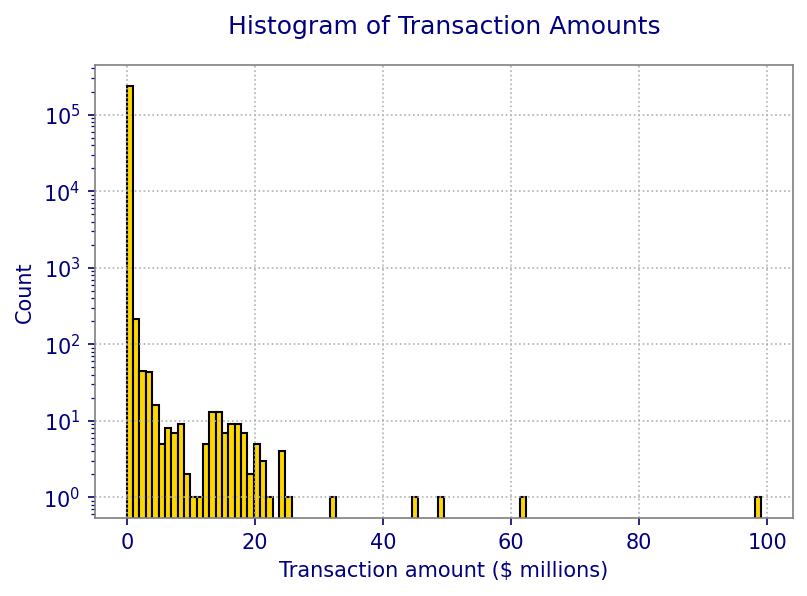

In [18]:
with plt.rc_context({'axes.edgecolor':'grey', 
                     'xtick.color':'navy', 
                     'ytick.color':'navy', 
                     'figure.figsize':(6,4),
                     'font.size':10}):
    
    ax = df.transaction_amount.apply(
        lambda x: abs(x)/1000000).plot(kind="hist", 
                                       color='gold',
                                       edgecolor='k',
                                       bins=100)
    
    plt.title('Histogram of Transaction Amounts', color='navy', pad=15)
    ax.xaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}'))
    plt.xlabel('Transaction amount ($ millions)', color='navy')
    plt.ylabel('Count', color='navy')
    plt.grid(linestyle=':')
    plt.yscale('log');

In [262]:
fig = px.histogram(df, x='transaction_amount', log_y=True, nbins=100,
                   title='Histogram of Transaction Amounts', width=900)

fig.update_traces(
    marker_line_width=1, 
    marker_line_color='black',
    marker=dict(color='gold'),
)

fig.update_xaxes(title='Transaction amount ($ millions)',
                 range=[-2000000,102000000],
                 gridcolor='lightgray',
                 showgrid=True, 
                 gridwidth=1)

fig.update_yaxes(title='Count (log-scaled)',
                 gridcolor='lightgray',
                 showgrid=True, 
                 gridwidth=1)

fig.update_layout(paper_bgcolor='rgba(0,0,0,0)',
                  plot_bgcolor='rgba(0,0,0,0)',
                  hoverlabel=dict(
                      bgcolor='ivory',
                      font_size=16,
                      font_family='Rockwell'),
                  font=dict(family='Rockwell', 
                            color='navy',
                            size=16), 
                  title_x=0.5)

In [263]:
report = dp.Report(dp.Plot(fig))
report.save('transaction_histogram.html', open=True)
report.upload(name='transaction_histogram', 
              visibility=dp.Visibility.DEFAULT,
              formatting=dp.ReportFormatting(
                  width=dp.ReportWidth.NARROW)
             )

Report saved to ./transaction_histogram.html

Uploading report and associated data - *please wait...*

Your report only contains a single element - did you know you can include additional plots, tables and text in a single report? More info <a href='https://docs.datapane.com/reports/blocks/layout-pages-and-selects' target='_blank'>here</a>

Report successfully uploaded. View and share your report <a href='https://datapane.com/u/zachwolinsky/reports/Xkn1VN7/transaction-histogram/' target='_blank'>here</a>, or edit your report <a href='https://datapane.com/u/zachwolinsky/reports/Xkn1VN7/transaction-histogram/edit/' target='_blank'>here</a>.

### We can see from the histogram above that most transactions are for $1,000,000 or less. We can also already see there are some outlier transactions that are much larger than the majority of transactions.

In [12]:
(df.department_title.value_counts()/df.department_title.value_counts().sum()*100)[0:5].sum()

59.6159803092585

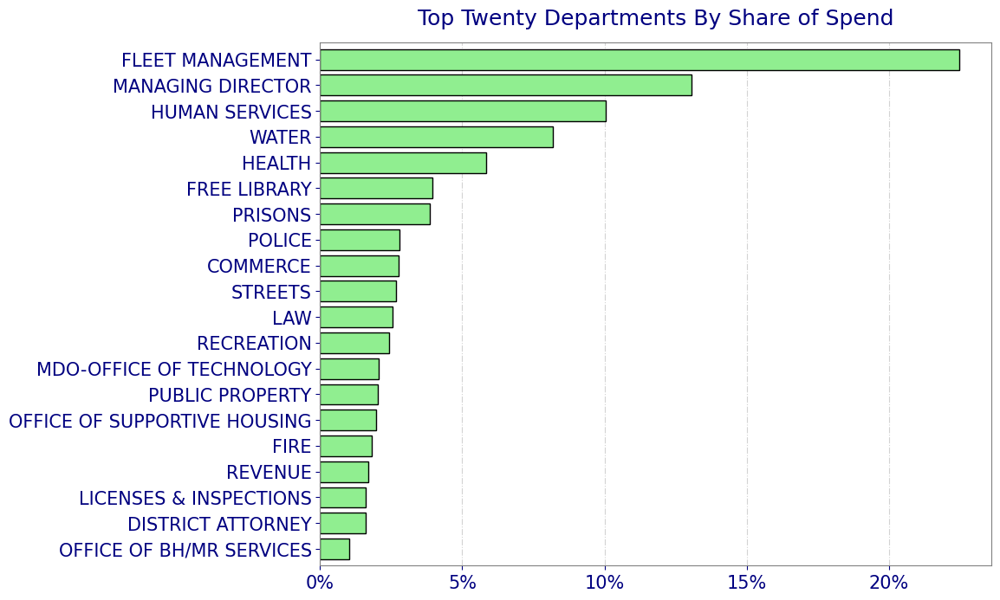

In [19]:
top_twenty_depts = (df.department_title.value_counts()\
                    / df.department_title.value_counts().sum()\
                    * 100).head(20)[::-1]

plt.figure(figsize=(10,8), dpi=100)

with plt.rc_context({'axes.edgecolor':'grey', 
                     'xtick.color':'navy', 
                     'ytick.color':'navy',
                     'font.size':15}):
    
    ax = top_twenty_depts.plot(kind='barh', 
                               width=.8, 
                               color='lightgreen', 
                               edgecolor='k')
    
    ax.set_title('Top Twenty Departments By Share of Spend', 
                 color='navy', pad=15)
    
    xticks = mtick.FormatStrFormatter('%.0f%%')
    ax.xaxis.set_major_formatter(xticks)
    ax.set_axisbelow(True)
    ax.xaxis.grid(color='lightgrey', 
                  linestyle='-.');

In [30]:
top_twenty_depts = (df.department_title.value_counts()\
                    / df.department_title.value_counts().sum()\
                    * 100).head(20)[::-1]

top_twenty_depts = top_twenty_depts.reset_index().rename(
    columns={'department_title':'share',
             'index':'department'})

fig = px.bar(top_twenty_depts, x='share', y='department',
             title='Top Twenty Departments By Share of Spend',
             width=700, orientation='h')

fig.update_traces(marker_line_width=1, 
                  marker_line_color='black',
                  marker=dict(color='lightgreen'),
                  hovertemplate='<br>'.join([
                      'Department: %{y}',
                      'Share: %{x:.2f}%']))

fig.update_xaxes(title='Share of spend',
                 range=[-0.25,23],
                 gridcolor='lightgray',
                 showgrid=True, 
                 gridwidth=1, 
                 tickvals=[0,5,10,15,20],
                 ticktext=[f'{x}%' for x in range(0,21,5)])

fig.update_yaxes(title='',
                 gridcolor='lightgray',
                 showgrid=True, 
                 gridwidth=1)

fig.update_layout(title_font_size=20,
                  paper_bgcolor='rgba(0,0,0,0)',
                  plot_bgcolor='rgba(0,0,0,0)',
                  showlegend=False,
                  hoverlabel=dict(
                      bgcolor='ivory',
                      font_size=16,
                      font_family='Rockwell'),
                  font=dict(family='Rockwell', 
                            color='navy',
                            size=12), 
                  title_x=0.5)
fig.show()

In [31]:
report = dp.Report(dp.Plot(fig))
report.save('dept_share_of_spend.html', open=True)
report.upload(name='dept_share_of_spend', 
              visibility=dp.Visibility.DEFAULT,
              formatting=dp.ReportFormatting(
                  width=dp.ReportWidth.NARROW)
             )

Report saved to ./dept_share_of_spend.html

Uploading report and associated data - *please wait...*

Your report only contains a single element - did you know you can include additional plots, tables and text in a single report? More info <a href='https://docs.datapane.com/reports/blocks/layout-pages-and-selects' target='_blank'>here</a>

Report successfully uploaded. View and share your report <a href='https://datapane.com/u/zachwolinsky/reports/d7dmMMk/dept-share-of-spend/' target='_blank'>here</a>, or edit your report <a href='https://datapane.com/u/zachwolinsky/reports/d7dmMMk/dept-share-of-spend/edit/' target='_blank'>here</a>.

In [12]:
df.doc_ref_no_prefix_definition.value_counts()

procurement                                         93119
auto parts                                          40038
professional services                               36793
court appointed attorneys                           28521
payment voucher                                     16831
petty cash                                          12175
library books                                        4702
reimbursable expense vouchers for City employees     4447
American Express travel vouchers                     1802
monthly rent and quarterly MH/MR                      327
funeral directors                                      88
None                                                   51
Name: doc_ref_no_prefix_definition, dtype: int64

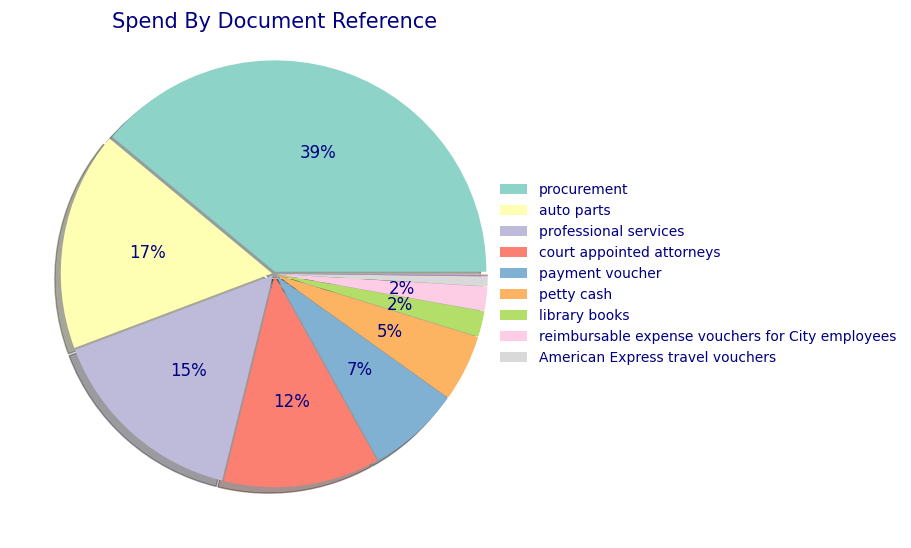

In [20]:
# Make a pie plot showing the document reference categories
doc_ref_df = df.doc_ref_no_prefix_definition.value_counts()

explode = [0.01 for i in range(doc_ref_df.shape[0])]
plt.figure(figsize=(9,7), dpi=100)
plt.tight_layout()

# supress autopct values less than 2%
autopct = lambda x: f'{x:.0f}%' if x >= 1 else None

ax = doc_ref_df.plot.pie(cmap='Set3', 
                         explode=explode, 
                         autopct=autopct,
                         textprops={'color':'navy'},
                         labels=['' for i in range(20)],
                         shadow=True, fontsize=12)

ax.set_title('Spend By Document Reference', fontsize=15, 
             color='navy', y=.95)

ax.legend(loc='right', labels=doc_ref_df.index[:9], 
          frameon=False,bbox_to_anchor=(1.7, 0.5))

leg = ax.get_legend()
for text in leg.get_texts():
    text.set_color('navy')
ax.set_ylabel('');

In [260]:
doc_ref_df.doc_ref_no_prefix_definition / doc_ref_df.doc_ref_no_prefix_definition.sum() * 100

0     38.979213
1     16.759734
2     15.401391
3     11.938768
4      7.045384
5      5.096403
6      1.968237
7      1.861495
8      0.754309
9      0.136881
10     0.036836
11     0.021348
Name: doc_ref_no_prefix_definition, dtype: float64

In [32]:
doc_ref_df = df.doc_ref_no_prefix_definition.value_counts().reset_index()
doc_ref_df.doc_ref_no_prefix_definition = doc_ref_df.doc_ref_no_prefix_definition\
/ doc_ref_df.doc_ref_no_prefix_definition.sum() * 100

fig = px.pie(doc_ref_df, names='index', values='doc_ref_no_prefix_definition',
             labels='index', title='Spend By Document Reference'+\
             '<br><sup>hover over to see labels</sup>',
             hole=0.5, color_discrete_sequence=px.colors.qualitative.Set3, 
             width=500, height=500).update_traces(marker_line_color='rgb(0,0,0)',
                                                  textinfo='none',
                                                  hovertemplate='<br>'.join([
                                                      'doc ref:  %{label}',
                                                      'share of spend:  '+\
                                                      '%{value:.2f}%']),
                                                  textfont_size=14,
                                                  marker_line_width=1)
fig.update_layout(title_font_size=20,
                  showlegend=False,
                  hoverlabel=dict(
                      bgcolor='ivory',
                      font_size=16,
                      font_family='Rockwell'),
                  font=dict(family='Rockwell', 
                            color='navy',
                            size=12), 
                  title_x=0.5)
fig.show()

In [33]:
report = dp.Report(dp.Plot(fig))
report.save('spend_by_doc_ref.html', open=True)
report.upload(name='spend_by_doc_ref', 
              visibility=dp.Visibility.DEFAULT,
              formatting=dp.ReportFormatting(
                  width=dp.ReportWidth.NARROW)
             )

Report saved to ./spend_by_doc_ref.html

Uploading report and associated data - *please wait...*

Your report only contains a single element - did you know you can include additional plots, tables and text in a single report? More info <a href='https://docs.datapane.com/reports/blocks/layout-pages-and-selects' target='_blank'>here</a>

Report successfully uploaded. View and share your report <a href='https://datapane.com/u/zachwolinsky/reports/MA14K9k/spend-by-doc-ref/' target='_blank'>here</a>, or edit your report <a href='https://datapane.com/u/zachwolinsky/reports/MA14K9k/spend-by-doc-ref/edit/' target='_blank'>here</a>.

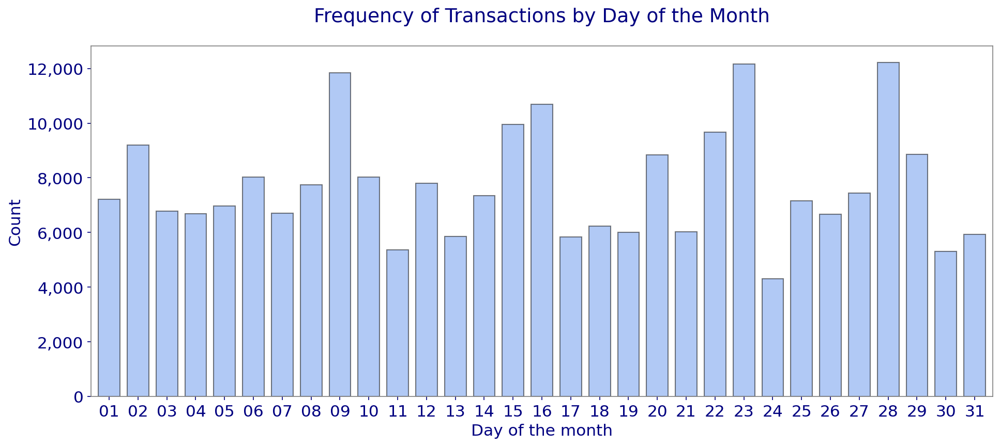

In [22]:
with plt.rc_context({'font.size':15,
                     'axes.edgecolor':'grey',
                     'xtick.color':'navy', 
                     'ytick.color':'navy',}):
    
    ax = df.day.value_counts().sort_index().plot(kind='bar', 
                                                 figsize=(15,6), 
                                                 color='cornflowerblue',
                                                 edgecolor='k', 
                                                 alpha=0.5, width=.75)
    
    ax.set_title('Frequency of Transactions by Day of the Month', 
                 color='navy', y=1.05)
    ax.set_ylabel('Count', color='navy')
    ax.set_xlabel('Day of the month', color='navy')
    ticks_loc = ax.get_yticks().tolist()
    ax.yaxis.set_major_locator(mtick.FixedLocator(ticks_loc))
    ax.set_yticklabels(['{:,.0f}'.format(x) for x in ticks_loc])
    plt.xticks(rotation=0);

In [34]:
day_counts = df.day.value_counts().sort_index().reset_index()
day_counts.rename(columns={'index':'day','day':'count'}, inplace=True)

fig = px.line(day_counts, x='day', y='count', 
              title='Frequency of Transactions by Day of the Month')

fig.update_traces(mode='markers+lines')

fig.update_xaxes(gridcolor='lightgray',
                 showgrid=True, 
                 gridwidth=1)

fig.update_yaxes(gridcolor='lightgray',
                 showgrid=True, 
                 gridwidth=1)

fig.update_layout(paper_bgcolor='rgba(0,0,0,0)',
                  plot_bgcolor='rgba(0,0,0,0)',
                  title_font_size=20,
                  showlegend=False,
                  hoverlabel=dict(
                      bgcolor='ivory',
                      font_size=16,
                      font_family='Rockwell'),
                  font=dict(family='Rockwell', 
                            color='navy',
                            size=14), 
                  title_x=0.5)

fig.show()

In [35]:
report = dp.Report(dp.Plot(fig))
report.save('daily_trans_frequency.html', open=True)
report.upload(name='daily_trans_frequency', 
              visibility=dp.Visibility.DEFAULT,
              formatting=dp.ReportFormatting(
                  width=dp.ReportWidth.NARROW)
             )

Report saved to ./daily_trans_frequency.html

How is your experience of Datapane? Please take two minutes to answer our anonymous product survey <a href='https://bit.ly/3lWjRlr' target='_blank'>here</a>

Uploading report and associated data - *please wait...*

Your report only contains a single element - did you know you can include additional plots, tables and text in a single report? More info <a href='https://docs.datapane.com/reports/blocks/layout-pages-and-selects' target='_blank'>here</a>

Report successfully uploaded. View and share your report <a href='https://datapane.com/u/zachwolinsky/reports/Y3Yo8ek/daily-trans-frequency/' target='_blank'>here</a>, or edit your report <a href='https://datapane.com/u/zachwolinsky/reports/Y3Yo8ek/daily-trans-frequency/edit/' target='_blank'>here</a>.

In [23]:
df.head()

,document_no,department_title,character_title,sub_obj_title,vendor_name,doc_ref_no_prefix_definition,contract_description,transaction_amount,amount_sign,payment_method,weekday,day,month,year
0,CHEK17119771,COMMERCE,PURCHASE OF SERVICES,OVERTIME MEALS,EAT AT JOE'S,payment voucher,None,66.82,1,CHEK,Wednesday,12,April,2017
1,ACHD17177233,LICENSES & INSPECTIONS,PURCHASE OF SERVICES,TRANSPORTATION,L & I Â TRAVEL IMPREST FUND,payment voucher,None,127.33,1,ACHD,Friday,09,June,2017
2,CHEK17063736,LAW,PURCHASE OF SERVICES,COURT REPORTERS,"MARLENE BELL REPORTING, INC.",payment voucher,None,454.20,1,CHEK,Friday,25,November,2016
3,CHEK17000247,POLICE,PURCHASE OF SERVICES,REPAIR AND MAINTENANCE CHARGES,RICOH AMERICAS CORPORATION,procurement,None,50.00,1,CHEK,Thursday,07,July,2016
4,ACHD17000233,PRISONS,MATERIALS AND SUPPLIES,FOOD,PHILADELPHIA PRISONS,petty cash,None,71.92,1,ACHD,Friday,08,July,2016


In [4]:
# determine categorical and numerical features
numerical = df.select_dtypes(include=['int64', 'float64']).columns
categorical = df.select_dtypes(include=['object', 'bool']).columns

In [5]:
print(numerical)
print(categorical)

Index(['transaction_amount', 'amount_sign'], dtype='object')
Index(['document_no', 'department_title', 'character_title', 'sub_obj_title',
       'vendor_name', 'doc_ref_no_prefix_definition', 'contract_description',
       'payment_method', 'weekday', 'day', 'month', 'year'],
      dtype='object')


In [6]:
le = defaultdict(LabelEncoder)

In [7]:
# Label encoding
Y = df[categorical].apply(lambda x: le[x.name].fit_transform(x))
Y = pd.concat([Y, df[numerical]], axis=1)

In [10]:
Y.head()

,document_no,department_title,character_title,sub_obj_title,vendor_name,doc_ref_no_prefix_definition,contract_description,payment_method,weekday,day,month,year,transaction_amount,amount_sign
0,212404,13,4,104,1560,7,1120,1,4,11,0,1,66.82,1
1,106470,24,4,201,2894,7,1120,0,0,8,6,1,127.33,1
2,168343,23,4,32,3211,7,1120,1,0,24,9,0,454.20,1
3,119090,44,4,180,4274,9,1120,1,2,6,5,0,50.00,1
4,209,45,3,50,3959,8,1120,0,0,7,5,0,71.92,1


In [57]:
# Inverse label encoding
# Y = Y[categorical].apply(lambda x: le[x.name].inverse_transform(x))
# Y = pd.concat([Y, df[numerical]], axis=1)

In [58]:
# Y.head()

,department_title,character_title,sub_obj_title,vendor_name,doc_ref_no_prefix_definition,contract_description,payment_method,weekday,day,month,year,transaction_amount,amount_sign
document_no,,,,,,,,,,,,,
CHEK17119771,COMMERCE,PURCHASE OF SERVICES,OVERTIME MEALS,EAT AT JOE'S,payment voucher,None,CHEK,Wednesday,12,April,2017,66.82,1
ACHD17177233,LICENSES & INSPECTIONS,PURCHASE OF SERVICES,TRANSPORTATION,L & I Â TRAVEL IMPREST FUND,payment voucher,None,ACHD,Friday,09,June,2017,127.33,1
CHEK17063736,LAW,PURCHASE OF SERVICES,COURT REPORTERS,"MARLENE BELL REPORTING, INC.",payment voucher,None,CHEK,Friday,25,November,2016,454.20,1
CHEK17000247,POLICE,PURCHASE OF SERVICES,REPAIR AND MAINTENANCE CHARGES,RICOH AMERICAS CORPORATION,procurement,None,CHEK,Thursday,07,July,2016,50.00,1
ACHD17000233,PRISONS,MATERIALS AND SUPPLIES,FOOD,PHILADELPHIA PRISONS,petty cash,None,ACHD,Friday,08,July,2016,71.92,1


#### Now, for purposes of this demostration we will use a subset of the data for faster training

In [8]:
# Take a sample that will become our X matrix
df_sample = df.sample(n=128*373, random_state=1729).drop(columns='document_no')

# Take another sample using the same random_sate
# thus, same indices as df_sample, to use to recover labels
Y_sample = Y.sample(n=128*373, random_state=1729)

In [12]:
df_sample.shape , Y_sample.shape

((47744, 13), (47744, 14))

In [20]:
# Y_sample.reset_index(inplace=True)
Y_sample.head()

,document_no,department_title,character_title,sub_obj_title,vendor_name,doc_ref_no_prefix_definition,contract_description,payment_method,weekday,day,month,year,transaction_amount,amount_sign
214627,197810,25,4,84,5475,3,1120,1,2,1,7,1,250.00,1
46641,223236,25,4,84,3606,3,1120,1,2,17,8,1,150.00,1
119334,148015,39,4,179,4007,9,1461,1,2,5,10,0,853.00,1
17132,7159,21,3,100,4688,9,1560,0,0,28,5,0,14.63,1
131162,155558,19,3,96,2205,2,1120,1,2,19,10,0,25.62,1


In [81]:
# Inverse label encoding
# Y_sample = Y_sample[categorical].apply(lambda x: le[x.name].inverse_transform(x))
# Y_sample = pd.concat([Y_sample, df_sample[numerical]], axis=1)
# Y_sample.head()

,document_no,department_title,character_title,sub_obj_title,vendor_name,doc_ref_no_prefix_definition,contract_description,payment_method,weekday,day,month,year,transaction_amount,amount_sign
CHEK17101085,CHEK17101085,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,250.00,1.0
CHEK17133085,CHEK17133085,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,150.00,1.0
CHEK17037586,CHEK17037586,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,853.00,1.0
ACHD17013816,ACHD17013816,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14.63,1.0
CHEK17047593,CHEK17047593,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,25.62,1.0


### Now let's encode the categorical features using one-hot-encoding.

In [9]:
%%time
# create dummy variables, except for document_no (first column)
X = pd.get_dummies(df_sample, drop_first=True)

CPU times: total: 1.02 s
Wall time: 1.07 s


In [14]:
X

,transaction_amount,amount_sign,department_title_BOARD OF ETHICS,department_title_BOARD OF LICENSES & INSPECTIONS,department_title_BOARD OF PENSIONS,department_title_BOARD OF REVISION OF TAXES,department_title_CITY COMMISSIONERS,department_title_CITY CONTROLLER,department_title_CITY COUNCIL,department_title_CITY PLANNING COMMISSION,...,month_February,month_January,month_July,month_June,month_March,month_May,month_November,month_October,month_September,year_2017
214627,250.00,1,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,1
46641,150.00,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,1
119334,853.00,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
17132,14.63,1,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
131162,25.62,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112632,12.97,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
30153,20898.96,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
156728,840.85,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
8980,29.59,1,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0


### We need to scale the transaction amount. It will be useful to use the MinMaxScaler to bound the values beween zero and one.

In [10]:
# fit the scaler
scaler = MinMaxScaler().fit(
    X.transaction_amount.to_numpy().reshape(-1,1))

# transform the data
X.transaction_amount = scaler.transform(
    X.transaction_amount.to_numpy().reshape(-1,1))

# See the result
X

,transaction_amount,amount_sign,department_title_BOARD OF ETHICS,department_title_BOARD OF LICENSES & INSPECTIONS,department_title_BOARD OF PENSIONS,department_title_BOARD OF REVISION OF TAXES,department_title_CITY COMMISSIONERS,department_title_CITY CONTROLLER,department_title_CITY COUNCIL,department_title_CITY PLANNING COMMISSION,...,month_February,month_January,month_July,month_June,month_March,month_May,month_November,month_October,month_September,year_2017
214627,4.029497e-06,1,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,1
46641,2.417634e-06,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,1
119334,1.374903e-05,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
17132,2.356544e-07,1,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
131162,4.127982e-07,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112632,2.088975e-07,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
30153,3.368625e-04,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
156728,1.355319e-05,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
8980,4.767892e-07,1,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0


In [25]:
report = dp.Report(
  dp.Text('## Embedded transaction data'),
  dp.DataTable(X.head(10), caption="First 10 observations"),
)

report.upload(name='embedded_philly_data', visibility=dp.Visibility.DEFAULT)

c:\users\e079051\desktop\udacity_data_scientist_capstone_project\venv\lib\site-packages\datapane\common\df_processor.py:28: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(df.index, pd.Int64Index):


Uploading report and associated data - *please wait...*

Your report only contains a single element - did you know you can include additional plots, tables and text in a single report? More info <a href='https://docs.datapane.com/reports/blocks/layout-pages-and-selects' target='_blank'>here</a>

Report successfully uploaded. View and share your report <a href='https://datapane.com/u/zachwolinsky/reports/VkGbM07/embedded-philly-data/' target='_blank'>here</a>, or edit your report <a href='https://datapane.com/u/zachwolinsky/reports/VkGbM07/embedded-philly-data/edit/' target='_blank'>here</a>.

In [87]:
# inverse minmax scale trans amount
# X.transaction_amount = scaler.inverse_transform(
#     X.transaction_amount.to_numpy().reshape(-1,1))

# See the result
# X

,transaction_amount,amount_sign,department_title_BOARD OF ETHICS,department_title_BOARD OF LICENSES & INSPECTIONS,department_title_BOARD OF PENSIONS,department_title_BOARD OF REVISION OF TAXES,department_title_CITY COMMISSIONERS,department_title_CITY CONTROLLER,department_title_CITY COUNCIL,department_title_CITY PLANNING COMMISSION,...,month_February,month_January,month_July,month_June,month_March,month_May,month_November,month_October,month_September,year_2017
document_no,,,,,,,,,,,,,,,,,,,,,
CHEK17101085,250.00,1,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,1
CHEK17133085,150.00,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,1
CHEK17037586,853.00,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
ACHD17013816,14.63,1,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
CHEK17047593,25.62,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ACHD17042012,12.97,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
ACHD17154563,20898.96,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
ACHD17075706,840.85,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0


### The final preprocessing step is to convert the X and Y matrices into a `torch.Tensor` object

In [11]:
%%time
X_ = torch.FloatTensor(X.values)

CPU times: total: 2.05 s
Wall time: 1.02 s


In [12]:
X_

tensor([[4.0295e-06, 1.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         1.0000e+00],
        [2.4176e-06, 1.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         1.0000e+00],
        [1.3749e-05, 1.0000e+00, 0.0000e+00,  ..., 1.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.3553e-05, 1.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.7679e-07, 1.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.9623e-07, 1.0000e+00, 0.0000e+00,  ..., 1.0000e+00, 0.0000e+00,
         0.0000e+00]])

In [13]:
%%time
Y_ = torch.FloatTensor(Y_sample.values)

CPU times: total: 0 ns
Wall time: 2.51 ms


In [14]:
Y_

tensor([[1.9781e+05, 2.5000e+01, 4.0000e+00,  ..., 1.0000e+00, 2.5000e+02,
         1.0000e+00],
        [2.2324e+05, 2.5000e+01, 4.0000e+00,  ..., 1.0000e+00, 1.5000e+02,
         1.0000e+00],
        [1.4802e+05, 3.9000e+01, 4.0000e+00,  ..., 0.0000e+00, 8.5300e+02,
         1.0000e+00],
        ...,
        [4.2957e+04, 5.5000e+01, 4.0000e+00,  ..., 0.0000e+00, 8.4085e+02,
         1.0000e+00],
        [2.4960e+03, 1.6000e+01, 4.0000e+00,  ..., 0.0000e+00, 2.9590e+01,
         1.0000e+00],
        [3.3598e+04, 2.2000e+01, 4.0000e+00,  ..., 0.0000e+00, 3.7000e+01,
         1.0000e+00]])

In [15]:
def recover_labels(Y):
    '''
    Recover data labels from tensor to pandas DataFrame
    '''
    recovered_y = pd.concat([
        pd.DataFrame(Y, columns=Y_sample.columns)[categorical].astype('int32')\
        .apply(lambda x: le[x.name].inverse_transform(x)), 
        pd.DataFrame(Y, columns=Y_sample.columns)[numerical]
    ], axis=1)
    
    return recovered_y

In [21]:
recover_labels(Y_).head()

,document_no,department_title,character_title,sub_obj_title,vendor_name,doc_ref_no_prefix_definition,contract_description,payment_method,weekday,day,month,year,transaction_amount,amount_sign
0,CHEK17101085,MANAGING DIRECTOR,PURCHASE OF SERVICES,LEGAL SERVICES,YALONDA E HOUSTON,court appointed attorneys,None,CHEK,Thursday,02,March,2017,250.000000,1.0
1,CHEK17133085,MANAGING DIRECTOR,PURCHASE OF SERVICES,LEGAL SERVICES,NGHI D VO,court appointed attorneys,None,CHEK,Thursday,18,May,2017,150.000000,1.0
2,CHEK17037586,OFFICE OF HOUSING,PURCHASE OF SERVICES,RENTS,PITNEY BOWES INCORPORATED,procurement,Rental of Pitney Bowes Mailing Equipment,CHEK,Thursday,06,October,2016,853.000000,1.0
3,ACHD17013816,HEALTH,MATERIALS AND SUPPLIES,OFFICE MATERIALS AND SUPPLIES,STAPLES BUSINESS ADVANTAGE,procurement,STAPLES CONTRACT & COMMERCIAL INC Bid # 010615NJ,ACHD,Friday,29,July,2016,14.630000,1.0
4,CHEK17047593,FLEET MANAGEMENT,MATERIALS AND SUPPLIES,MOTOR VEHICLE PARTS AND ACCESSORIES,IEH AUTO PARTS LLC,auto parts,None,CHEK,Thursday,20,October,2016,25.620001,1.0


### Now we can define our autoencoder classes

In [45]:
class Encoder(nn.Module):
    def __init__(self, input_dims, latent_dims):
        super().__init__()
        self.linear1 = nn.Linear(input_dims, 512)
#         self.linear2 = nn.Linear(2048, 512)
        self.linear3 = nn.Linear(512, 128)
        self.linear4 = nn.Linear(128, latent_dims)
    
    def forward(self, x):
        x = F.leaky_relu(self.linear1(x))
#         x = F.leaky_relu(self.linear2(x))
        x = F.leaky_relu(self.linear3(x))
        x = F.leaky_relu(self.linear4(x))
        return x

In [46]:
class Decoder(nn.Module):
    def __init__(self, latent_dims, output_dims):
        super().__init__()
        self.linear1 = nn.Linear(latent_dims, 128)
        self.linear2 = nn.Linear(128, 512)
#         self.linear3 = nn.Linear(512, 2048)
        self.linear4 = nn.Linear(512, output_dims)
        
    def forward(self, z):
        z = F.leaky_relu(self.linear1(z))
        z = F.leaky_relu(self.linear2(z))
#         z = F.leaky_relu(self.linear3(z))
        z = torch.sigmoid(self.linear4(z))
        return z

In [47]:
class Autoencoder(nn.Module):
    def __init__(self, input_dims, latent_dims, output_dims):
        super().__init__()
        self.encoder = Encoder(input_dims, latent_dims)
        self.decoder = Decoder(latent_dims, output_dims)
    
    def forward(self, x):
        z = self.encoder(x)
        return self.decoder(z)

In [48]:
def train(autoencoder, data, epochs=20):
    losses = []
    opt = torch.optim.Adam(autoencoder.parameters())
    for epoch in range(epochs):
        for x, y in data:
            x = x.to(device) # use GPU if available
            opt.zero_grad()
            x_hat = autoencoder(x)
            loss = ((x - x_hat)**2).sum()
            losses.append(loss)
            loss.backward()
            opt.step()
    return autoencoder, losses

In [49]:
dataset = torch.utils.data.TensorDataset(X_, Y_)
data = torch.utils.data.DataLoader(dataset, batch_size=128, shuffle=True)

#### Training a deeper network

In [21]:
%%time

latent_dims = 2
input_dims = X_.shape[1]
output_dims = X_.shape[1]

autoencoder = Autoencoder(input_dims, latent_dims, output_dims).to(device)
autoencoder, losses = train(autoencoder, data)

CPU times: total: 5h 4min 30s
Wall time: 1h 18min 28s


In [22]:
torch.save(autoencoder, 'deep_autoencoder')

In [29]:
pd.Series([float(x.detach()) for x in losses]).to_csv('deep_losses.csv')

#### Using activation on last forward layer on shallower network

In [50]:
%%time

latent_dims = 2
input_dims = X_.shape[1]
output_dims = X_.shape[1]

autoencoder = Autoencoder(input_dims, latent_dims, output_dims).to(device)
autoencoder, losses = train(autoencoder, data)

CPU times: total: 54min 38s
Wall time: 14min 1s


In [332]:
class Encoder(nn.Module):
    def __init__(self, input_dims):
        super().__init__()
        self.linear = nn.Linear(input_dims, 2**11)
        self.linears = nn.ModuleList([
            nn.Linear(2**(11-i), 2**(10-i)) for i in range(10)
        ])
    
    def forward(self, x):
        x = F.leaky_relu(self.linear(x))
        for l in self.linears:
            x = F.leaky_relu(l(x))
        return x

In [333]:
class Decoder(nn.Module):
    def __init__(self, output_dims):
        super().__init__()
        self.linears = nn.ModuleList([
            nn.Linear(2**(10-i), 2**(11-i)) for i in range(10)[::-1]
        ])
        self.linear = nn.Linear(2**11, output_dims)
        
    def forward(self, z):
        for l in self.linears:
            z = F.leaky_relu(l(z))
        z = F.leaky_relu(self.linear(z))
        return torch.sigmoid(z)

In [334]:
class Autoencoder(nn.Module):
    def __init__(self, input_dims, output_dims):
        super().__init__()
        self.encoder = Encoder(input_dims)
        self.decoder = Decoder(output_dims)
    
    def forward(self, x):
        z = self.encoder(x)
        return self.decoder(z)

In [335]:
def train(autoencoder, data, epochs=20):
    losses = []
    opt = torch.optim.Adam(autoencoder.parameters())
    for epoch in range(epochs):
        for x, y in data:
            x = x.to(device) # use GPU if available
            opt.zero_grad()
            x_hat = autoencoder(x)
            loss = ((x - x_hat)**2).sum()
            losses.append(loss)
            loss.backward()
            opt.step()
    return autoencoder, losses

In [20]:
dataset = torch.utils.data.TensorDataset(X_, Y_)
data = torch.utils.data.DataLoader(dataset, batch_size=128, shuffle=True)

In [21]:
%%time

latent_dims = 2
input_dims = X_.shape[1]
output_dims = X_.shape[1]

autoencoder = Autoencoder(input_dims, latent_dims, output_dims).to(device)
autoencoder, losses = train(autoencoder, data)

CPU times: total: 5h 4min 30s
Wall time: 1h 18min 28s


In [22]:
torch.save(autoencoder, 'deep_autoencoder')

In [29]:
pd.Series([float(x.detach()) for x in losses]).to_csv('deep_losses.csv')

In [1]:
import torch
from data.preprocessing import Preprocessor
data = torch.load('data/philly_payments_clean')

In [ ]:
data.

In [3]:
from models.models import Autoencoder

In [4]:
latent_dims = 2
input_dims = data.X_.shape[1]
output_dims = data.X_.shape[1]

model = Autoencoder(input_dims, latent_dims, output_dims)
model.fit(data.dataset, epochs=10)

epoch [1/10] | loss: 752.0183 | elapsed time: 0.54 minutes
epoch [2/10] | loss: 716.3547 | elapsed time: 0.53 minutes
epoch [3/10] | loss: 703.7274 | elapsed time: 0.51 minutes
epoch [4/10] | loss: 662.5021 | elapsed time: 0.55 minutes
epoch [5/10] | loss: 705.8345 | elapsed time: 0.52 minutes
epoch [6/10] | loss: 636.6057 | elapsed time: 0.51 minutes
epoch [7/10] | loss: 625.0417 | elapsed time: 0.51 minutes
epoch [8/10] | loss: 613.5272 | elapsed time: 0.51 minutes
epoch [9/10] | loss: 634.9485 | elapsed time: 0.52 minutes
epoch [10/10] | loss: 611.115 | elapsed time: 0.51 minutes


In [5]:
model.project(data.dataset)

In [6]:
model.projection

tensor([[ 0.6255, -0.8384],
        [-0.4332, -0.8471],
        [ 1.3544,  0.0822],
        ...,
        [-0.0016,  1.0029],
        [-0.6822, -0.3459],
        [ 0.5394, -0.8889]])

In [3]:
from models.models import VAE

In [9]:
latent_dims = 2
input_dims = data.X_.shape[1]
output_dims = data.X_.shape[1]

model = VAE(input_dims, latent_dims, output_dims)
model.fit(data.dataset, epochs=20)

epoch [1/20] | loss: 1347.5662 | elapsed time: 0.55 minutes
epoch [2/20] | loss: 1294.4917 | elapsed time: 0.55 minutes
epoch [3/20] | loss: 1078.4147 | elapsed time: 0.56 minutes
epoch [4/20] | loss: 1083.2185 | elapsed time: 0.57 minutes
epoch [5/20] | loss: 1068.0616 | elapsed time: 0.56 minutes
epoch [6/20] | loss: 1042.6199 | elapsed time: 0.56 minutes
epoch [7/20] | loss: 1048.6682 | elapsed time: 0.57 minutes
epoch [8/20] | loss: 1027.5453 | elapsed time: 0.57 minutes
epoch [9/20] | loss: 1037.9078 | elapsed time: 0.57 minutes
epoch [10/20] | loss: 1035.2323 | elapsed time: 0.56 minutes
epoch [11/20] | loss: 1026.3595 | elapsed time: 0.56 minutes
epoch [12/20] | loss: 1021.7184 | elapsed time: 0.62 minutes
epoch [13/20] | loss: 990.6225 | elapsed time: 0.56 minutes
epoch [14/20] | loss: 1043.9874 | elapsed time: 0.57 minutes
epoch [15/20] | loss: 1021.3472 | elapsed time: 0.55 minutes
epoch [16/20] | loss: 1011.476 | elapsed time: 0.55 minutes
epoch [17/20] | loss: 1025.0978 | e

In [3]:
from models.models import VAE

In [4]:
latent_dims = 2
input_dims = data.X_.shape[1]
output_dims = data.X_.shape[1]

model = VAE(input_dims, latent_dims, output_dims)
model.fit(data.dataset, epochs=10)

epoch [1/10] | loss: 944.2666 | elapsed time: 0.54 minutes
epoch [2/10] | loss: 822.33 | elapsed time: 0.56 minutes
epoch [3/10] | loss: 782.7068 | elapsed time: 0.55 minutes
epoch [4/10] | loss: 747.4534 | elapsed time: 0.55 minutes
epoch [5/10] | loss: 772.1864 | elapsed time: 0.56 minutes
epoch [6/10] | loss: 762.8928 | elapsed time: 0.56 minutes
epoch [7/10] | loss: 798.8724 | elapsed time: 0.56 minutes
epoch [8/10] | loss: 782.2275 | elapsed time: 0.57 minutes
epoch [9/10] | loss: 784.5326 | elapsed time: 0.57 minutes
epoch [10/10] | loss: 800.2548 | elapsed time: 0.56 minutes


In [8]:
labels = np.empty((0, 14))
projections = np.empty((0, 2))
for i, (x, y) in enumerate(data.dataset):
    z = model.encode(x.to(device))
    z = z.to('cpu').detach().numpy()
    projections = np.vstack((projections, z))
    labels = np.vstack((labels, y))
    if i == 10:
        break

In [9]:
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 150

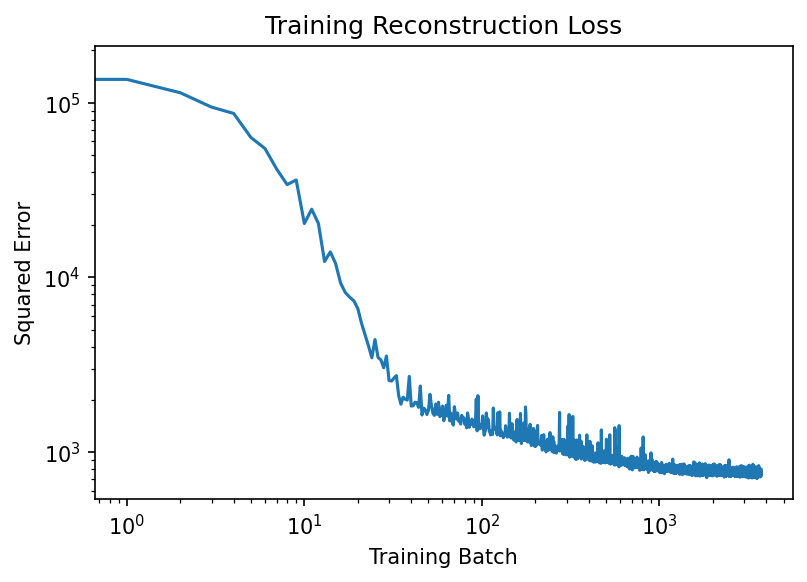

In [7]:
# plot the loss over progression of training
plt.plot([x.detach() for x in model.losses])
plt.title('Training Reconstruction Loss')
plt.xlabel('Training Batch')
plt.ylabel('Squared Error')
plt.yscale('log')
plt.xscale('log');

In [27]:
autoencoder = torch.load('trained_autoencoder')

In [31]:
losses = pd.read_csv('training_loss.csv')

In [75]:
torch.save(autoencoder, 'trained_autoencoder')

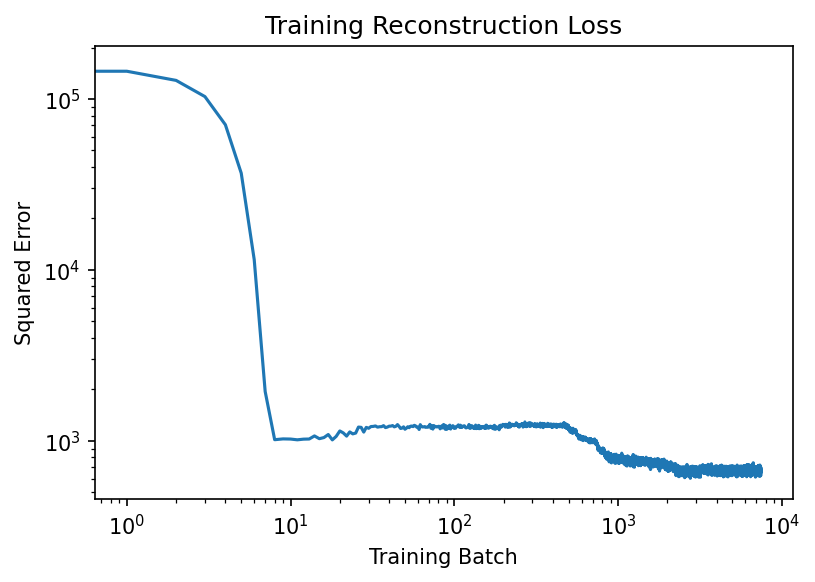

In [23]:
# plot the loss over progression of training
plt.plot([x.detach() for x in losses])
plt.title('Training Reconstruction Loss')
plt.xlabel('Training Batch')
plt.ylabel('Squared Error')
plt.yscale('log')
plt.xscale('log');

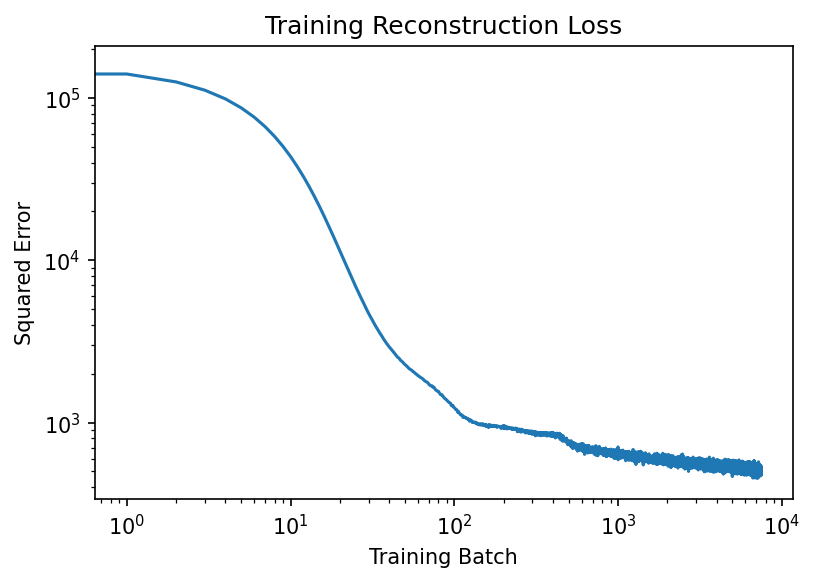

In [41]:
# plot the loss over progression of training
plt.plot([x.detach() for x in losses])
plt.title('Training Reconstruction Loss')
plt.xlabel('Training Batch')
plt.ylabel('Squared Error')
plt.yscale('log')
plt.xscale('log');

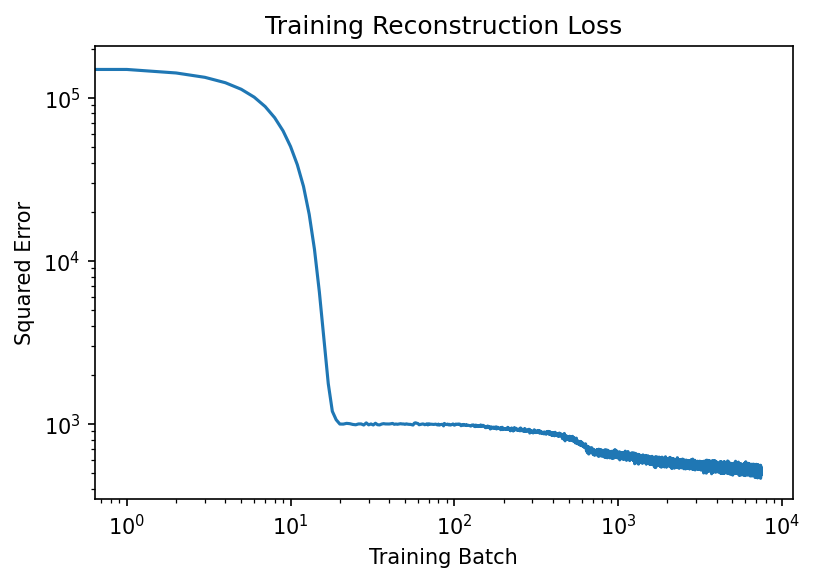

In [51]:
# plot the loss over progression of training
plt.plot([x.detach() for x in losses])
plt.title('Training Reconstruction Loss')
plt.xlabel('Training Batch')
plt.ylabel('Squared Error')
plt.yscale('log')
plt.xscale('log');

In [68]:
fig = px.line(y=[x.detach() for x in losses], log_x=True, log_y=True, 
              labels={'x':'Batch Number', 'y':'Squared Error'})

fig.update_traces(mode='markers+lines')

fig.update_traces(marker_line_width=1, 
                  marker_line_color='black',
                  marker=dict(color='lightgreen'),
                  hovertemplate='<br>'.join([
                      'Batch Number: %{x}',
                      'Squared Error: %{y:,.0f}']))

fig.update_xaxes(gridcolor='lightgray',
                 showgrid=True, 
                 gridwidth=1)

fig.update_yaxes(gridcolor='lightgray',
                 showgrid=True, 
                 gridwidth=1)

fig.update_layout(title_font_size=20,
                  title_text='Training Reconstruction Loss',
                  paper_bgcolor='rgba(0,0,0,0)',
                  plot_bgcolor='rgba(0,0,0,0)',
                  showlegend=False,
                  hoverlabel=dict(
                      bgcolor='ivory',
                      font_size=16,
                      font_family='Rockwell'),
                  font=dict(family='Rockwell', 
                            color='navy',
                            size=16), 
                  title_x=0.5)
fig.show()

In [65]:
report = dp.Report(dp.Plot(fig))
report.save('training_reconstruction_loss.html', open=True)
report.upload(name='training_reconstruction_loss', 
              visibility=dp.Visibility.DEFAULT,
              formatting=dp.ReportFormatting(
                  width=dp.ReportWidth.NARROW)
             )

Report saved to ./training_reconstruction_loss.html

Uploading report and associated data - *please wait...*

Your report only contains a single element - did you know you can include additional plots, tables and text in a single report? More info <a href='https://docs.datapane.com/reports/blocks/layout-pages-and-selects' target='_blank'>here</a>

Report successfully uploaded. View and share your report <a href='https://datapane.com/u/zachwolinsky/reports/9Arb6mA/training-reconstruction-loss/' target='_blank'>here</a>, or edit your report <a href='https://datapane.com/u/zachwolinsky/reports/9Arb6mA/training-reconstruction-loss/edit/' target='_blank'>here</a>.

In [74]:
# pd.Series([int(x.detach()) for x in losses], name='training_loss').to_csv('training_loss.csv')

In [54]:
labels = np.empty((0, 14))
projections = np.empty((0, 2))
for i, (x, y) in enumerate(data):
    z = autoencoder.encoder(x.to(device))
    z = z.to('cpu').detach().numpy()
    projections = np.vstack((projections, z))
    labels = np.vstack((labels, y))
    if i == 10:
        break

In [97]:
recover_labels(labels).head()

,document_no,department_title,character_title,sub_obj_title,vendor_name,doc_ref_no_prefix_definition,contract_description,payment_method,weekday,day,month,year,transaction_amount,amount_sign
0,CHEK17019529,MANAGING DIRECTOR,PURCHASE OF SERVICES,LEGAL SERVICES,GARY SANFORD SERVER,court appointed attorneys,None,CHEK,Thursday,18,August,2016,250.000000,1.0
1,ACHD17159323,PUBLIC PROPERTY,MATERIALS AND SUPPLIES,OFFICE MATERIALS AND SUPPLIES,STAPLES BUSINESS ADVANTAGE,procurement,STAPLES CONTRACT & COMMERCIAL INC Bid # 010615NJ,ACHD,Friday,05,May,2017,1859.099976,1.0
2,CHEK17054344,FLEET MANAGEMENT,MATERIALS AND SUPPLIES,MOTOR VEHICLE PARTS AND ACCESSORIES,WINNER FORD,auto parts,None,CHEK,Thursday,10,November,2016,160.089996,1.0
3,ACHD17062149,FLEET MANAGEMENT,MATERIALS AND SUPPLIES,GASOLINE,MANSFIELD OIL COMPANY OF GAINESVILLE INC,procurement,RFG Gasoline and Bio Diesel Fuel (5%),ACHD,Friday,04,November,2016,12581.599609,1.0
4,ACHD17055800,WATER,MATERIALS AND SUPPLIES,FIRE FIGHTING AND SAFETY,FERGUSON ENTERPRISES,procurement,"Fire Hydrants, Assemblies and Components",ACHD,Friday,14,October,2016,393.750000,1.0


In [11]:
# Get feature names for plotting
feature_names = dict(zip(range(len(data.categorical)+\
                               len(data.numerical)-1),
                         data.categorical.tolist()[1:]+\
                         data.numerical.tolist()))
feature_names

{0: 'department_title',
 1: 'character_title',
 2: 'sub_obj_title',
 3: 'vendor_name',
 4: 'doc_ref_no_prefix_definition',
 5: 'contract_description',
 6: 'payment_method',
 7: 'weekday',
 8: 'day',
 9: 'month',
 10: 'year',
 11: 'transaction_amount',
 12: 'amount_sign'}

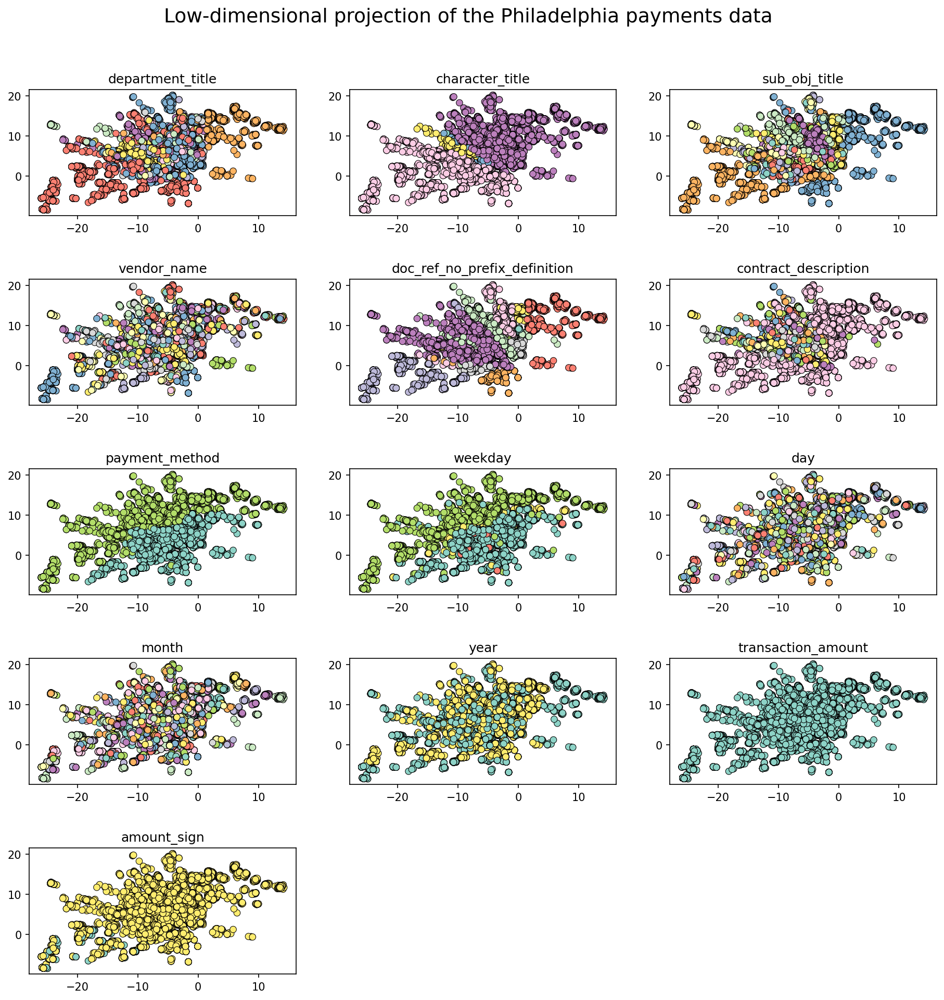

In [80]:
# plot the low-dimensional projection and color by the 
plt.figure(figsize=(15, 15))
plt.subplots_adjust(hspace=0.5)
plt.suptitle('Low-dimensional projection of the Philadelphia payments data', 
             fontsize=18, y=0.95)

for key, value in feature_names.items():
    ax = plt.subplot(5, 3, key+1)
    ax.scatter(projections[:,0], 
               projections[:,1], 
               c=labels[:,key+1], 
               cmap='Set3', 
               edgecolors='k',
               lw=0.5)
    ax.set_title(f'{value}');

In [289]:
data_ = recover_labels(labels)

fig = px.scatter(data_frame=data_, x=projections[:,0], y=projections[:,1], color=labels[:,5],
                 title= 'Low-dimensional projection of the Philadelphia payments data'+\
                 '<br><sup>Colored by document reference number prefix definition</sup>',
                 color_continuous_scale=px.colors.qualitative.Set3, width=900, height=600, 
                 custom_data=data_.columns, labels={'x':'$\Large{z_1}$', 'y':'$\Large{z_2}$'})

fig.update_traces(marker=dict(size=12, line=dict(width=0.5, color='DarkSlateGrey')),
                  selector=dict(mode='markers'))

fig.update_traces(hovertemplate='<br>'.join([
    'Transaction Amount: %{customdata[12]:$,.2f}'+\
    ', Sign: %{customdata[13]}',
    'Document Number: %{customdata[0]}',
    'Department Title: %{customdata[1]}',
    'Character Title: %{customdata[2]}',
    'Sub Object Title: %{customdata[3]}',
    'Vendor Name: %{customdata[4]}',
    'Doc Ref No. Prefix Definition: %{customdata[5]}',
    'Contract Description: %{customdata[6]}',
    'Payment Method: %{customdata[7]}',
    'Date: %{customdata[8]}, %{customdata[10]}'+\
    ' %{customdata[9]}, %{customdata[11]}',
    ]))

fig.update_layout(hovermode='y unified',
                  paper_bgcolor='rgba(0,0,0,0)',
                  plot_bgcolor='rgba(0,0,0,0)',
                  font=dict(
                      family='Rockwell', 
                      size=16, 
                      color='navy'),
                  hoverlabel=dict(
                      bgcolor='rgba(255,255,255,0.7)',
                      font_size=16,
                      font_family='Rockwell'))

fig.update_coloraxes(showscale=False)

fig.show()

In [79]:
report = dp.Report(dp.Plot(fig))
report.save('philly_payments_projection.html', open=True)
report.upload(name='philly_payments_projection', 
              visibility=dp.Visibility.DEFAULT,
              formatting=dp.ReportFormatting(
                  width=dp.ReportWidth.NARROW)
             )

Report saved to ./philly_payments_projection.html

Uploading report and associated data - *please wait...*

Your report only contains a single element - did you know you can include additional plots, tables and text in a single report? More info <a href='https://docs.datapane.com/reports/blocks/layout-pages-and-selects' target='_blank'>here</a>

Report successfully uploaded. View and share your report <a href='https://datapane.com/u/zachwolinsky/reports/d7dm4Mk/philly-payments-projection/' target='_blank'>here</a>, or edit your report <a href='https://datapane.com/u/zachwolinsky/reports/d7dm4Mk/philly-payments-projection/edit/' target='_blank'>here</a>.

In [188]:
data_ = recover_labels(labels)

plot_list = []
for key, value in feature_names.items():
    plot_list.append(
        dp.Plot(
            px.scatter(
                data_frame=data_, 
                x=projections[:,0], 
                y=projections[:,1],
                color=labels[:,key+1],
                title= 'Low-dimensional projection' +\
                ' of the Philadelphia payments data',
                color_continuous_scale=px.colors.qualitative.Set3, 
                custom_data=data_.columns, 
                labels={'x':'z.1', 'y':'z.2'}
            ).update_traces(
                marker=dict(size=12, 
                            line=dict(width=0.5, 
                                      color='DarkSlateGrey')
                           ),
                selector=dict(mode='markers'),
                hovertemplate='<br>'.join([
                'Transaction Amount: %{customdata[12]:$,.2f}'+\
                ', Sign: %{customdata[13]}',
                'Document Number: %{customdata[0]}',
                'Department Title: %{customdata[1]}',
                'Character Title: %{customdata[2]}',
                'Sub Object Title: %{customdata[3]}',
                'Vendor Name: %{customdata[4]}',
                'Doc Ref No. Prefix Definition: %{customdata[5]}',
                'Contract Description: %{customdata[6]}',
                'Payment Method: %{customdata[7]}',
                'Date: %{customdata[8]}, %{customdata[10]}'+\
                ' %{customdata[9]}, %{customdata[11]}',
                ])
            ).update_layout(
                hovermode='y unified',
                paper_bgcolor='rgba(0,0,0,0)',
                plot_bgcolor='rgba(0,0,0,0)',
                font=dict(
                    family='Rockwell', 
                    size=16, 
                    color='navy'),
                hoverlabel=dict(
                    bgcolor='rgba(255,255,255,0.7)',
                    font_size=16,
                    font_family='Rockwell')
            ).update_coloraxes(showscale=False), 
            label=value
        )
    )

In [192]:
report = dp.Report(
    dp.Select(blocks=plot_list)
)

report.save('philly_payments_projection.html', open=True)

report.upload(name='philly_payments_projection', 
              visibility=dp.Visibility.DEFAULT,
              formatting=dp.ReportFormatting(
                  width=dp.ReportWidth.NARROW)
             )

Report saved to ./philly_payments_projection.html

Uploading report and associated data - *please wait...*

Your report only contains a single element - did you know you can include additional plots, tables and text in a single report? More info <a href='https://docs.datapane.com/reports/blocks/layout-pages-and-selects' target='_blank'>here</a>

Report successfully uploaded. View and share your report <a href='https://datapane.com/u/zachwolinsky/reports/O7vqy13/philly-payments-projection/' target='_blank'>here</a>, or edit your report <a href='https://datapane.com/u/zachwolinsky/reports/O7vqy13/philly-payments-projection/edit/' target='_blank'>here</a>.

In [13]:
import plotly.express as px
import plotly.graph_objects as go

In [8]:
data_ = data.recover_labels(model.labels)

fig = px.scatter()

fig.add_trace(
    go.Scatter(
        x=model.projection[:,0], 
        y=model.projection[:,1],
        mode='markers',
        marker=dict(size=12,
                    color=model.labels[:,5],
                    colorscale=px.colors.qualitative.Set3,
                    line=dict(width=0.5,
                              color='DarkSlateGrey'),
                   ),
        showlegend=False,
        customdata=data_,
        name=''
    )
)
            
fig.update_traces(
        selector=dict(mode='markers'),
        hovertemplate='<br>'.join([
        'Transaction Amount: %{customdata[12]:$,.2f}'+\
        ', Sign: %{customdata[13]}',
        'Document Number: %{customdata[0]}',
        'Department Title: %{customdata[1]}',
        'Character Title: %{customdata[2]}',
        'Sub Object Title: %{customdata[3]}',
        'Vendor Name: %{customdata[4]}',
        'Doc Ref No. Prefix Definition: %{customdata[5]}',
        'Contract Description: %{customdata[6]}',
        'Payment Method: %{customdata[7]}',
        'Date: %{customdata[8]}, %{customdata[10]}'+\
        ' %{customdata[9]}, %{customdata[11]}',
        ])
    )
        
fig.update_layout(
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    font=dict(
        family='Rockwell', 
        size=16, 
        color='navy'),
    hoverlabel=dict(
        font_size=14,
        font_family='Rockwell'),
    title_text='Low-dimensional projection of' +\
    '<br>the Philadelphia payments data',
    title_font_size=18,
    title_y=.92,
    title_x=.95,
    xaxis={'title':'Z.1'},
    yaxis={'title':'Z.2'}
)

fig.update_xaxes(gridcolor='lightgray',
                 showgrid=True, 
                 gridwidth=1)

fig.update_yaxes(gridcolor='lightgray',
                 showgrid=True, 
                 gridwidth=1)

buttons = []
for index, feature in data.feature_names.items():
    if index not in [8,9,10]: # exclude day, month, year
        args = dict(size=12,
                    color=model.labels[:,index+1],
                    colorscale=fig.data[0].marker.colorscale,
                    line=dict(width=0.5,
                              color='DarkSlateGrey')
                   )

        #create a button object for the feature we are on
        button = dict(label=feature,
                      method='update',
                      args=[{'marker':args}])

        #add the button to our list of buttons
        buttons.append(button)
        
fig.update_layout(
    updatemenus=[dict(
        active=4,
        font={'size':12},
        bgcolor='white',
        type='dropdown',
        buttons=buttons,
        xanchor='left',
        yanchor='bottom',
        y=1,
        x=0,
    )], 
)

fig.show()

In [9]:
report = dp.Report(dp.Plot(fig))
report.save('batch_normalized_ae_example.html', open=True)
# report.upload(name='philly_payments_projected', 
#               visibility=dp.Visibility.DEFAULT,
#               formatting=dp.ReportFormatting(
#                   width=dp.ReportWidth.NARROW)
#              )

Report saved to ./batch_normalized_ae_example.html

In [263]:
fig.write_html('projection.html')

In [4]:
pip install datapane

     ---------------------------------------- 2.6/2.6 MB 7.9 MB/s eta 0:00:00
     -------------------------------------- 193.7/193.7 KB 5.9 MB/s eta 0:00:00
     --------------------------------------- 14.5/14.5 MB 11.1 MB/s eta 0:00:00
     -------------------------------------- 155.4/155.4 KB 9.7 MB/s eta 0:00:00
     ---------------------------------------- 3.6/3.6 MB 11.0 MB/s eta 0:00:00
  Using cached munch-2.5.0-py2.py3-none-any.whl (10 kB)
     ------------------------------------- 210.8/210.8 KB 12.5 MB/s eta 0:00:00
     ---------------------------------------- 2.1/2.1 MB 10.5 MB/s eta 0:00:00
     ---------------------------------------- 46.5/46.5 KB ? eta 0:00:00
     -------------------------------------- 812.8/812.8 KB 8.5 MB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     ---------------------------------------- 55.8/55.8 KB 2.9 MB/s eta 0:00:00
  Using cached chardet-4.0.0-py2.py3-none-any.whl (17

In [46]:
!datapane login --token=7906d35553820a774805f7ad1aaa6a18bb636b2a

Connected successfully to https://datapane.com as zachwolinsky


In [2]:
import altair as alt
from vega_datasets import data
import datapane as dp

df = data.cars()

plot1 = alt.Chart(df).mark_circle(size=60).encode(
    x='Horsepower', y='Miles_per_Gallon', color='Origin',
    tooltip=['Name', 'Origin', 'Horsepower', 'Miles_per_Gallon']
).interactive()
dp.Report(
    dp.Plot(plot1),
    dp.DataTable(df)
).upload(name="My example report")

Uploading report and associated data - *please wait...*

Your report only contains a single element - did you know you can include additional plots, tables and text in a single report? More info <a href='https://docs.datapane.com/reports/blocks/layout-pages-and-selects' target='_blank'>here</a>

Report successfully uploaded. View and share your report <a href='https://datapane.com/u/zachwolinsky/reports/wAwNpok/my-example-report/' target='_blank'>here</a>, or edit your report <a href='https://datapane.com/u/zachwolinsky/reports/wAwNpok/my-example-report/edit/' target='_blank'>here</a>.

In [7]:
pip install pyarrow

Note: you may need to restart the kernel to use updated packages.


In [204]:
pip install chart-studio

     ---------------------------------------- 64.4/64.4 KB 1.7 MB/s eta 0:00:00
     ---------------------------------------- 63.1/63.1 KB ? eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Using cached idna-3.3-py3-none-any.whl (61 kB)
     -------------------------------------- 138.7/138.7 KB 8.6 MB/s eta 0:00:00
  Using cached certifi-2021.10.8-py2.py3-none-any.whl (149 kB)
Using legacy 'setup.py install' for retrying, since package 'wheel' is not installed.
  Running setup.py install for retrying: started
  Running setup.py install for retrying: finished with status 'done'
Note: you may need to restart the kernel to use updated packages.


In [272]:
import chart_studio
username='zach.wolinsky'
api_key='SjAMBE6V5vFTi1EIYz3Y'
chart_studio.tools.set_credentials_file(
    username=username, api_key=api_key
)

In [283]:
import chart_studio.plotly as py
import chart_studio.tools as tls
py.plot(fig, filename='projection', auto_open = True)

'https://plotly.com/~zach.wolinsky/1/'

In [238]:
fig.data[0].marker.color

{0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0}

In [252]:
pd.DataFrame(projections, columns=['z1','z2'])

,z1,z2
0,6.837734,15.467577
1,-1.804699,-0.339432
2,-17.897121,0.985603
3,-11.176834,2.661348
4,-8.748826,3.959903
...,...,...
12923,-0.002948,14.207741
12924,4.178080,13.834450
12925,-9.761739,3.415769
12926,-1.577960,8.928001


In [258]:
pd.DataFrame(labels[:,5], columns=['colors'])

,colors
0,3.0
1,9.0
2,2.0
3,9.0
4,9.0
...,...
12923,11.0
12924,3.0
12925,9.0
12926,7.0


In [260]:
new_df = pd.concat([
    pd.DataFrame(projections, columns=['z1','z2']),
    pd.DataFrame(labels[:,5], columns=['colors']),
    data], axis=1
)

In [261]:
new_df.to_csv('projection_data.csv', index=False)

In [56]:
def plot_projection(autoencoder, data, label=0, num_batches=100):
    for i, (x, y) in enumerate(data):
        z = autoencoder.encoder(x.to(device))
        z = z.to('cpu').detach().numpy()
        plt.scatter(z[:, 0], z[:, 1], c=y[:,label], cmap='RdYlGn')           
        if i > num_batches:
            plt.title(f'Low-dimensional embedding of {label_names[label]} data')
            break

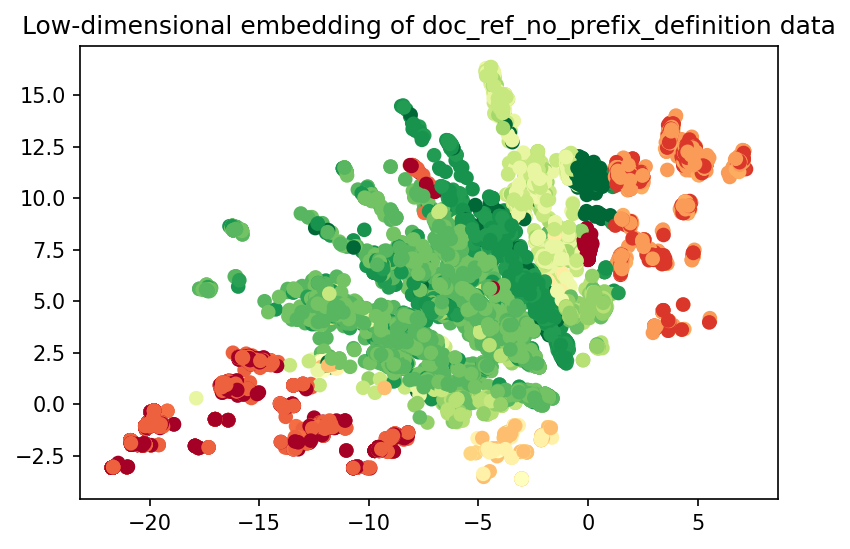

In [39]:
plot_projection(autoencoder, data)

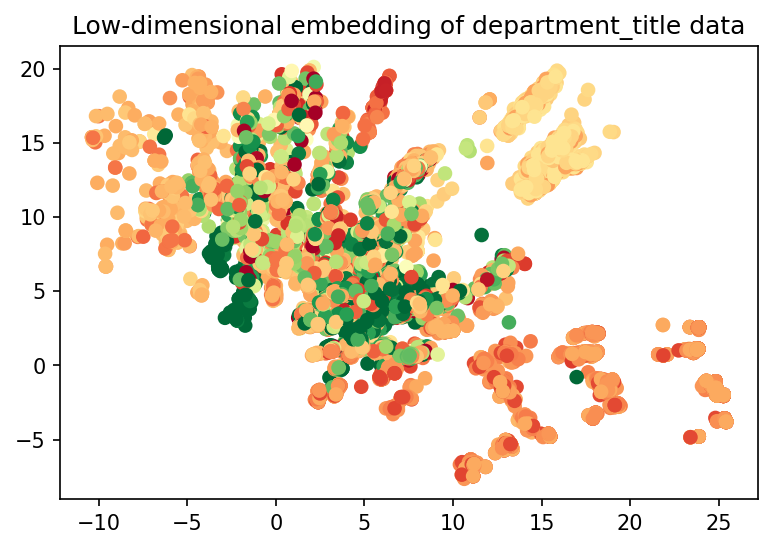

In [76]:
plot_projection(autoencoder, data)

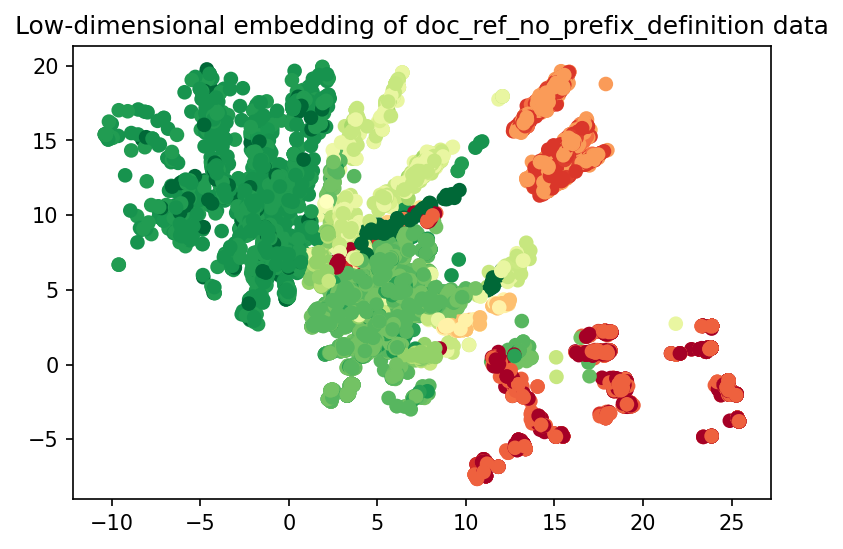

In [78]:
plot_projection(autoencoder, data)

In [58]:
class VariationalEncoder(nn.Module):
    def __init__(self, latent_dims):
        super(VariationalEncoder, self).__init__()
        self.linear1 = nn.Linear(4845, 512)
        self.linear2 = nn.Linear(512, latent_dims)
        self.linear3 = nn.Linear(512, latent_dims)
        self.N = torch.distributions.Normal(0, 1)
        self.kl = 0
    
    def forward(self, x):
        x = F.leaky_relu(self.linear1(x))
        mu =  self.linear2(x)
        sigma = torch.exp(self.linear3(x))
        z = mu + sigma*self.N.sample(mu.shape)
        self.kl = (sigma**2 + mu**2 - torch.log(sigma) - 0.5).sum()
        return z

In [59]:
class VariationalAutoencoder(nn.Module):
    def __init__(self, latent_dims):
        super(VariationalAutoencoder, self).__init__()
        self.encoder = VariationalEncoder(latent_dims)
        self.decoder = Decoder(latent_dims)
    
    def forward(self, x):
        z = self.encoder(x)
        return self.decoder(z)

In [63]:
def train(autoencoder, data, epochs=20):
    opt = torch.optim.Adam(autoencoder.parameters())
    for epoch in range(epochs):
        for x, y in data:
            x = x.to(device) # GPU
            opt.zero_grad()
            x_hat = autoencoder(x)
            loss = ((x - x_hat)**2).sum() + autoencoder.encoder.kl
            loss.backward()
            opt.step()
    return autoencoder

In [64]:
%%time
vae = VariationalAutoencoder(latent_dims).to(device) # GPU
vae = train(vae, data)

CPU times: total: 38min 42s
Wall time: 10min 5s


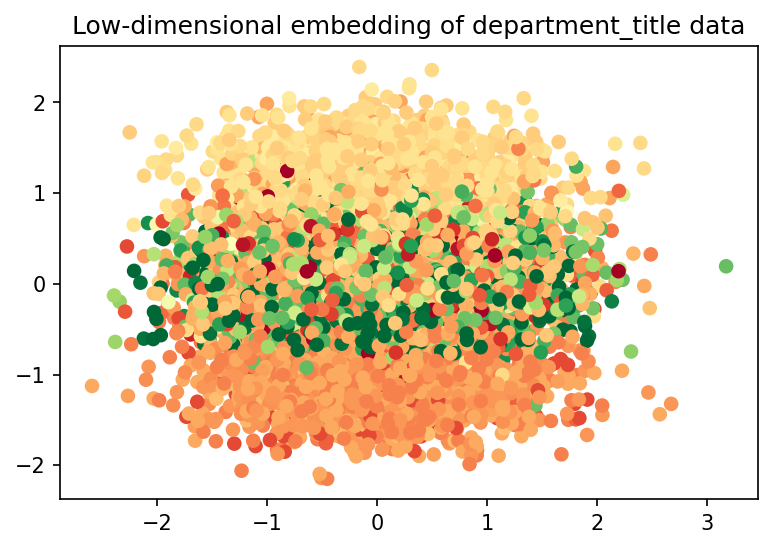

In [65]:
plot_projection(vae, data)

In [80]:
df.doc_ref_no_prefix_definition.unique()

array(['payment voucher', 'procurement', 'petty cash',
       'professional services', 'auto parts', 'library books',
       'court appointed attorneys', 'American Express travel vouchers',
       'reimbursable expense vouchers for City employees',
       'monthly rent and quarterly MH/MR', 'funeral directors', 'None'],
      dtype=object)

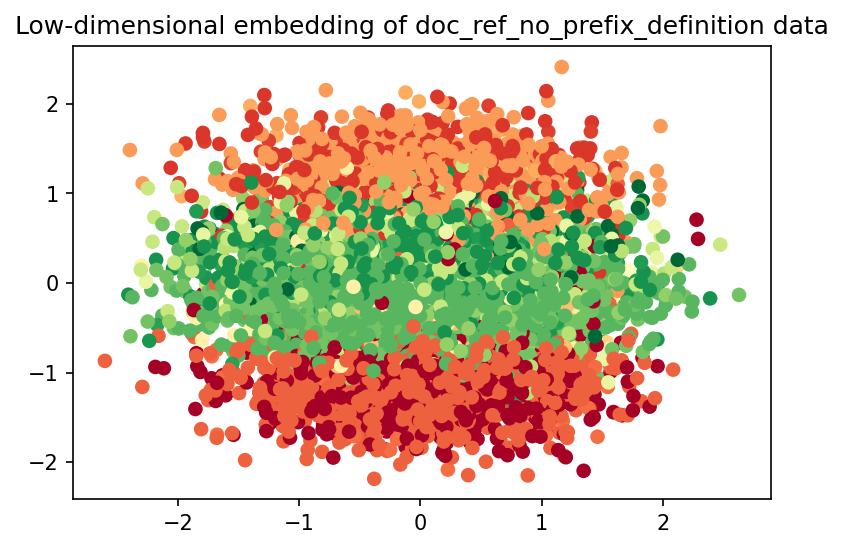

In [74]:
plot_projection(vae, data)

In [1]:
pip install SQLAlchemy

     ---------------------------------------- 1.6/1.6 MB 6.6 MB/s eta 0:00:00
  Using cached greenlet-1.1.2-cp38-cp38-win_amd64.whl (101 kB)



In [2]:
pip install torchinfo


You should consider upgrading via the 'c:\users\e079051\desktop\udacity_data_scientist_capstone_project\venv\scripts\python.exe -m pip install --upgrade pip' command.


In [3]:
pip install --upgrade pip

     ---------------------------------------- 2.1/2.1 MB 8.5 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 22.0.3
    Uninstalling pip-22.0.3:
      Successfully uninstalled pip-22.0.3



In [1]:
import pandas as pd

In [2]:
df = pd.read_csv('data/city_payments_fy2017.csv')

In [3]:
df.head()

,fy,fm,check_date,document_no,dept,department_title,char_,character_title,sub_obj,sub_obj_title,vendor_name,doc_ref_no_prefix,doc_ref_no_prefix_definition,contract_number,contract_description,transaction_amount
0,2017,10,2017-04-12,CHEK17119771,42,42 COMMERCE,2,02 PURCHASE OF SERVICES,231,OVERTIME MEALS 0231,EAT AT JOE'S,PVXX,payment voucher,NaN,NaN,66.82
1,2017,12,2017-06-09,ACHD17177233,26,26 LICENSES & INSPECTIONS,2,02 PURCHASE OF SERVICES,211,TRANSPORTATION 0211,L & I Â TRAVEL IMPREST FUND,PVXX,payment voucher,NaN,NaN,127.33
2,2017,5,2016-11-25,CHEK17063736,44,44 LAW,2,02 PURCHASE OF SERVICES,258,COURT REPORTERS 0258,"MARLENE BELL REPORTING, INC.",PVXX,payment voucher,NaN,NaN,454.20
3,2017,1,2016-07-07,CHEK17000247,11,11 POLICE,2,02 PURCHASE OF SERVICES,260,REPAIR AND MAINTENANCE CHARGES 0260,RICOH AMERICAS CORPORATION,VCXX,procurement,NaN,NaN,50.00
4,2017,1,2016-07-08,ACHD17000233,23,23 PRISONS,3,03 MATERIALS AND SUPPLIES,313,FOOD 0313,PHILADELPHIA PRISONS,PCXX,petty cash,NaN,NaN,71.92


In [4]:
from scripts.preprocessing import Preprocessor

In [5]:
data = Preprocessor()
data.process(df)

Cleaning data...
Label encoding the data...
Sampling from the original data...
One-hot-encoding the data...
Generating tensors...
Combining tensors into one dataset...
Preprocessing complete!
Total Time: 0.15 minutes


In [6]:
data.preprocessed.head()

,document_no,department_title,character_title,sub_obj_title,vendor_name,doc_ref_no_prefix_definition,contract_description,transaction_amount,amount_sign,payment_method,weekday,day,month,year
0,CHEK17119771,COMMERCE,PURCHASE OF SERVICES,OVERTIME MEALS,EAT AT JOE'S,payment voucher,None,66.82,1,CHEK,Wednesday,12,April,2017
1,ACHD17177233,LICENSES & INSPECTIONS,PURCHASE OF SERVICES,TRANSPORTATION,L & I Â TRAVEL IMPREST FUND,payment voucher,None,127.33,1,ACHD,Friday,09,June,2017
2,CHEK17063736,LAW,PURCHASE OF SERVICES,COURT REPORTERS,"MARLENE BELL REPORTING, INC.",payment voucher,None,454.20,1,CHEK,Friday,25,November,2016
3,CHEK17000247,POLICE,PURCHASE OF SERVICES,REPAIR AND MAINTENANCE CHARGES,RICOH AMERICAS CORPORATION,procurement,None,50.00,1,CHEK,Thursday,07,July,2016
4,ACHD17000233,PRISONS,MATERIALS AND SUPPLIES,FOOD,PHILADELPHIA PRISONS,petty cash,None,71.92,1,ACHD,Friday,08,July,2016


In [8]:
from scripts.models import AE, VAE

In [9]:
latent_dims = 2
input_dims = data.X_.shape[1]
output_dims = data.X_.shape[1]

model = AE(input_dims, latent_dims, output_dims, batch_norm=False)
model.fit(data.dataset, epochs=10)

epoch [1/10] | loss: 696.2939 | elapsed time: 0.47 minutes
epoch [2/10] | loss: 604.1718 | elapsed time: 0.5 minutes
epoch [3/10] | loss: 563.5091 | elapsed time: 0.5 minutes
epoch [4/10] | loss: 548.469 | elapsed time: 0.5 minutes
epoch [5/10] | loss: 569.556 | elapsed time: 0.51 minutes
epoch [6/10] | loss: 563.6557 | elapsed time: 0.5 minutes
epoch [7/10] | loss: 550.3657 | elapsed time: 0.51 minutes
epoch [8/10] | loss: 532.2272 | elapsed time: 0.52 minutes
epoch [9/10] | loss: 523.3024 | elapsed time: 0.53 minutes
epoch [10/10] | loss: 532.0402 | elapsed time: 0.52 minutes


In [10]:
model

AE(
  (bn1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (bn2): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (linear1): Linear(in_features=4845, out_features=512, bias=True)
  (linear2): Linear(in_features=512, out_features=2, bias=True)
  (linear3): Linear(in_features=2, out_features=512, bias=True)
  (linear4): Linear(in_features=512, out_features=4845, bias=True)
)

In [12]:
model.plot_loss()

In [13]:
model.plot_projection(data)

In [14]:
model = AE(input_dims, latent_dims, output_dims, batch_norm=True)
model.fit(data.dataset, epochs=10)

epoch [1/10] | loss: 744.4758 | elapsed time: 0.49 minutes
epoch [2/10] | loss: 719.2163 | elapsed time: 0.51 minutes
epoch [3/10] | loss: 691.4138 | elapsed time: 0.52 minutes
epoch [4/10] | loss: 662.4081 | elapsed time: 0.52 minutes
epoch [5/10] | loss: 654.9374 | elapsed time: 0.51 minutes
epoch [6/10] | loss: 665.4199 | elapsed time: 0.52 minutes
epoch [7/10] | loss: 604.636 | elapsed time: 0.53 minutes
epoch [8/10] | loss: 637.9259 | elapsed time: 0.52 minutes
epoch [9/10] | loss: 644.8177 | elapsed time: 0.52 minutes
epoch [10/10] | loss: 622.8604 | elapsed time: 0.53 minutes


In [15]:
model.plot_loss()

In [16]:
model.plot_projection(data)

In [17]:
import torch

In [18]:
torch.manual_seed(0)

In [19]:
model = AE(input_dims, latent_dims, output_dims, batch_norm=False)
model.fit(data.dataset, epochs=10)

epoch [1/10] | loss: 668.5126 | elapsed time: 0.49 minutes
epoch [2/10] | loss: 626.9844 | elapsed time: 0.5 minutes
epoch [3/10] | loss: 614.3066 | elapsed time: 0.61 minutes
epoch [4/10] | loss: 582.7828 | elapsed time: 0.58 minutes
epoch [5/10] | loss: 602.4752 | elapsed time: 0.56 minutes
epoch [6/10] | loss: 566.4155 | elapsed time: 0.56 minutes
epoch [7/10] | loss: 553.8221 | elapsed time: 0.56 minutes
epoch [8/10] | loss: 533.3305 | elapsed time: 0.57 minutes
epoch [9/10] | loss: 567.3764 | elapsed time: 0.73 minutes
epoch [10/10] | loss: 535.5759 | elapsed time: 1.01 minutes


In [20]:
model.plot_loss()

In [21]:
model.plot_projection(data)

In [22]:
model = AE(input_dims, latent_dims, output_dims, batch_norm=True)
model.fit(data.dataset, epochs=10)

epoch [1/10] | loss: 868.303 | elapsed time: 0.49 minutes
epoch [2/10] | loss: 672.885 | elapsed time: 0.53 minutes
epoch [3/10] | loss: 704.7212 | elapsed time: 0.51 minutes
epoch [4/10] | loss: 713.8654 | elapsed time: 0.51 minutes
epoch [5/10] | loss: 645.6183 | elapsed time: 0.52 minutes
epoch [6/10] | loss: 646.2235 | elapsed time: 0.52 minutes
epoch [7/10] | loss: 619.2828 | elapsed time: 0.51 minutes
epoch [8/10] | loss: 672.7318 | elapsed time: 0.51 minutes
epoch [9/10] | loss: 633.6851 | elapsed time: 0.54 minutes
epoch [10/10] | loss: 670.6669 | elapsed time: 0.52 minutes


In [23]:
model.plot_loss()

In [24]:
model.plot_projection(data)